Reading the data frame

In [42]:
import pandas as pd
df = pd.read_csv('Reviews.csv')
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


This dataset consists of reviews of fine foods from Amazon. It was collected over a period of 10 years and includes reviews up to October 2012. 
The dataset contains information about a product, the userid, the profile name for the name of the user and some information about the reviews that were posted by them. The helpfulness numerator is the number of users who found the review useful, the helpfulness deniminator happens to be the opposite. The score is the score that was given by the customer. A review contains a title/summary and the text/review. 

In [43]:
# 568454 rows and 10 columns
df.shape

(568454, 10)

In [44]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [45]:
# Importing relevant libraries 
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px

In [46]:
# Plotting the frequency of reviews for each product score
# most products received a score of 5 
# A higher score means a more positive review
# Most reviews are expected to be positive 
fig = px.histogram(df, x="Score")
plt.figure(figsize=(5,5))
fig.update_traces(marker_color="LightSkyBlue",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

<Figure size 360x360 with 0 Axes>

In [47]:
import nltk
from nltk.corpus import stopwords

In [48]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/nandhinishankar/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [49]:
# common words in English
# that don't add information to a sentence
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

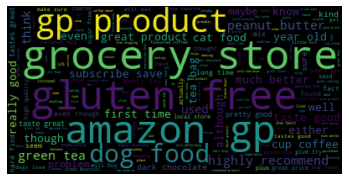

In [50]:
import wordcloud
from wordcloud import WordCloud, STOPWORDS
# Creating a stopword list:
stopwords = set(STOPWORDS)
stopwords.update(["br", "href"])
textt = " ".join(review for review in df.Text)
# we can use a wordcloud to see which words were 
# frequently used in the reviews
wordcloud = WordCloud(stopwords=stopwords).generate(textt)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud11.png')
plt.show()

We can see some positive words such as "highly recommend" and "great product" standing out in the word cloud. Most reviews in the dataset seem to express a positive sentiment.

## Classifying text 

In [51]:
# reviews with scores that are > 3 will be
# assigned with positive sentiment 
# if the scores are < 3
# negative sentiment 

# creating a dataframe with scores
# that aren't equal to 3
df = df[df['Score'] != 3]
# creating a sentiment column where 
# the sentiment is assigned based on the comparison
df['sentiment'] = df['Score'].apply(lambda rating : +1 if rating > 3 else -1)

In [52]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1


Let's build 2 word clouds for positive sentiment entries and negative sentiment entries 

In [53]:
# splitting the data frame into 2 data frames
# 1 - positive sentiment
# 2 - negative sentiment 
positive = df[df['sentiment'] == 1]
negative = df[df['sentiment'] == -1]

In [54]:
positive.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1
5,6,B006K2ZZ7K,ADT0SRK1MGOEU,Twoapennything,0,0,4,1342051200,Nice Taffy,I got a wild hair for taffy and ordered this f...,1
6,7,B006K2ZZ7K,A1SP2KVKFXXRU1,David C. Sullivan,0,0,5,1340150400,Great! Just as good as the expensive brands!,This saltwater taffy had great flavors and was...,1


In [55]:
negative.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,sentiment
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1
12,13,B0009XLVG0,A327PCT23YH90,LT,1,1,1,1339545600,My Cats Are Not Fans of the New Food,My cats have been happily eating Felidae Plati...,-1
16,17,B001GVISJM,A3KLWF6WQ5BNYO,Erica Neathery,0,0,2,1348099200,poor taste,I love eating them and they are good for watch...,-1
26,27,B001GVISJM,A3RXAU2N8KV45G,lady21,0,1,1,1332633600,Nasty No flavor,"The candy is just red , No flavor . Just plan...",-1


We can see that words such as "good" were used in reviews from the negative sentiment analysis table. 

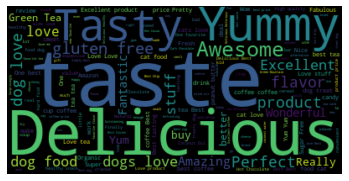

In [56]:
stopwords = set(STOPWORDS)
stopwords.update(["br", "href","good","great"]) 
# good and great removed because they were included in negative sentiment
# generating a word cloud from the
# summary column for the positive sentiment table
pos = " ".join(review for review in positive.Summary)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

We can see a bunch of words that seem to express a positive sentiment. "Awesome", "Delicious", "Yummy", "Excellent", "fantastic" and "Tasty" are some words that stand out. 

In [57]:
# before generating a word cloud for
# negative reviews
# let's see if there are any NaN values
# in the summary column 
negative.isna().sum() 

Id                         0
ProductId                  0
UserId                     0
ProfileName                5
HelpfulnessNumerator       0
HelpfulnessDenominator     0
Score                      0
Time                       0
Summary                   25
Text                       0
sentiment                  0
dtype: int64

We can see that there are 25 NaN values in Summary 

In [58]:
# let's replace the NaN values with
# string values before generating the word cloud
negative[['Summary']] = df[['Summary']].fillna('')

/Users/nandhinishankar/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:3065: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [59]:
# there are no Nan Values in Summary 
negative.isna().sum()

Id                        0
ProductId                 0
UserId                    0
ProfileName               5
HelpfulnessNumerator      0
HelpfulnessDenominator    0
Score                     0
Time                      0
Summary                   0
Text                      0
sentiment                 0
dtype: int64

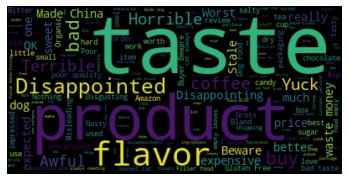

In [60]:
# generating a world cloud for the negative sentiment
# entries based on the summary column
neg = " ".join(review for review in negative.Summary)
wordcloud3 = WordCloud(stopwords=stopwords).generate(neg)
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud33.png')
plt.show()

We can see that the some of the most common words are "taste", "bad", "Disappointed", "Terrible", "Yuck" and "Horrible". 

In [61]:
df['sentimentt'] = df['sentiment'].replace({-1 : 'negative'})
df['sentimentt'] = df['sentimentt'].replace({1 : 'positive'})
fig = px.histogram(df, x="sentimentt")
plt.figure(figsize=(5,5))
fig.update_traces(marker_color="skyblue",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
fig.show()

<Figure size 360x360 with 0 Axes>

There are more positive reviews than negative reviews. 

## Sentiment Analysis Model 

In [62]:
# We will be making use of the summary column to make predictions
# we have to remove punctuation

def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"'))
    return final
df['Text'] = df['Text'].apply(remove_punctuation)
df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_punctuation)


In [63]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,sentiment,sentimentt
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1,positive
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1,negative
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,Delight says it all,This is a confection that has been around a fe...,1,positive
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1,negative
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price There was a wide...,1,positive


Let's create a new data frame with the variable we want to predict (sentiment) and the variable we need for prediction (Summary).

In [64]:
dfNew = df[['Summary','sentiment']]
dfNew.head()

,Summary,sentiment
0,Good Quality Dog Food,1
1,Not as Advertised,-1
2,Delight says it all,1
3,Cough Medicine,-1
4,Great taffy,1


In [65]:
# splitting train and test data
import numpy as np
index = dfNew.index
dfNew['random_number'] = np.random.randn(len(index))
train = dfNew[dfNew['random_number'] <= 0.8]
test = dfNew[dfNew['random_number'] > 0.8]

<ipython-input-65-b9de6e6cefe9>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [66]:
train

,Summary,sentiment,random_number
1,Not as Advertised,-1,-2.072066
3,Cough Medicine,-1,-0.078934
5,Nice Taffy,1,0.099272
6,Great Just as good as the expensive brands,1,0.072882
7,"Wonderful, tasty taffy",1,-0.368915
...,...,...,...
568449,Will not do without,1,-0.227823
568450,disappointed,-1,-2.756215
568451,Perfect for our maltipoo,1,-0.105895
568452,Favorite Training and reward treat,1,0.432221


In [67]:
test

,Summary,sentiment,random_number
0,Good Quality Dog Food,1,2.085049
2,Delight says it all,1,1.579347
4,Great taffy,1,1.055754
10,The Best Hot Sauce in the World,1,1.977913
11,My cats LOVE this diet food better than their ...,1,1.279145
...,...,...,...
568423,Good purchase,1,2.054135
568434,Not so good,-1,0.976468
568436,Baker's Ammonia Small quantity,1,0.906496
568439,a-ok,1,1.245253


## Creating a bag of words

In order to use textual data for predictive modeling, the text must be parsed to remove certain words – this process is called tokenization. These words need to then be encoded as integers, or floating-point values, for use as inputs in machine learning algorithms. This process is called feature extraction (or vectorization).

Scikit-learn’s CountVectorizer is used to convert a collection of text documents to a vector of term/token counts.

In [68]:
# list of text documents
from sklearn.feature_extraction.text import CountVectorizer
text = ["The grass is green and the sky is blue"]

vectorizer = CountVectorizer()
# tokenize and build vocab
vectorizer.fit(text)

print(vectorizer.vocabulary_)

# encode document
vector = vectorizer.transform(text)
# summarize encoded vector
print(vector.shape)
# this array contains the count for each word
# the: 2, grass: 1, is: 2, green: 1, and: 1, sky: 1, blue: 1
print(vector.toarray())

{'the': 6, 'grass': 2, 'is': 4, 'green': 3, 'and': 0, 'sky': 5, 'blue': 1}
(1, 7)
[[1 1 1 1 2 1 2]]


In [69]:
# count vectorizer
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
train_matrix = vectorizer.fit_transform(train['Summary'])
test_matrix = vectorizer.transform(test['Summary'])

In [70]:
# we can see that the text documents have been converted to a vector of term/token counts
print(test_matrix.shape)
print(test_matrix)

(110904, 31655)
  (0, 8623)	1
  (0, 11085)	1
  (0, 12194)	1
  (0, 22419)	1
  (1, 1368)	1
  (1, 7881)	1
  (1, 14708)	1
  (1, 24265)	1
  (2, 12498)	1
  (2, 27407)	1
  (3, 3114)	1
  (3, 13780)	1
  (3, 14230)	1
  (3, 24199)	1
  (3, 28023)	2
  (3, 30912)	1
  (4, 3162)	1
  (4, 4978)	1
  (4, 8221)	1
  (4, 11085)	2
  (4, 16613)	1
  (4, 18666)	1
  (4, 23023)	1
  (4, 28003)	1
  (4, 28044)	1
  :	:
  (110894, 21546)	1
  (110895, 3710)	1
  (110895, 10837)	1
  (110895, 12498)	1
  (110896, 12498)	1
  (110896, 27571)	1
  (110897, 14708)	1
  (110897, 16241)	1
  (110897, 29090)	1
  (110898, 6037)	2
  (110898, 31455)	1
  (110899, 12194)	1
  (110899, 22284)	1
  (110900, 12194)	1
  (110900, 19207)	1
  (110900, 25667)	1
  (110901, 1586)	1
  (110901, 2555)	1
  (110901, 22436)	1
  (110901, 23908)	1
  (110901, 25432)	1
  (110902, 752)	1
  (110902, 19626)	1
  (110903, 18022)	1
  (110903, 31042)	1


In [71]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(solver='lbfgs', max_iter=1000)

In [72]:
X_train = train_matrix
X_test = test_matrix
y_train = train['sentiment']
y_test = test['sentiment']

In [73]:
lr.fit(X_train,y_train)

LogisticRegression(max_iter=1000)

In [74]:
predictions = lr.predict(X_test)

In [75]:
# accuracy, precision, recall
# confusion matrix
from sklearn.metrics import confusion_matrix,classification_report
new = np.asarray(y_test)
confusion_matrix(predictions,y_test)

array([[11493,  2360],
       [ 5829, 91222]])

In [76]:
print(classification_report(predictions,y_test))

              precision    recall  f1-score   support

          -1       0.66      0.83      0.74     13853
           1       0.97      0.94      0.96     97051

    accuracy                           0.93    110904
   macro avg       0.82      0.88      0.85    110904
weighted avg       0.94      0.93      0.93    110904



The overall accuracy of this model is 93%. This is a decent percentage.